<a href="https://colab.research.google.com/github/SiddhantGodwani/Computer-Vision-/blob/main/Hands_on_Lab_Practice_Sheet_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [8]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import PIL.Image as Image
from skimage import io
import cv2
from google.colab.patches import cv2_imshow


In [2]:
#Read an image file
url="https://iiif.lib.ncsu.edu/iiif/0052574/full/800,/0/default.jpg"
imge = io.imread(url) # open an image
#Convert the image file to a matrix
image = np.array(imge)

In [3]:
#checking type of image
print("The loaded image is of type:",type(image))
print("The loaded image is of size:",image.shape)
print("intensity at index", image[50][50])

The loaded image is of type: <class 'numpy.ndarray'>
The loaded image is of size: (552, 800, 3)
intensity at index [114 170 219]


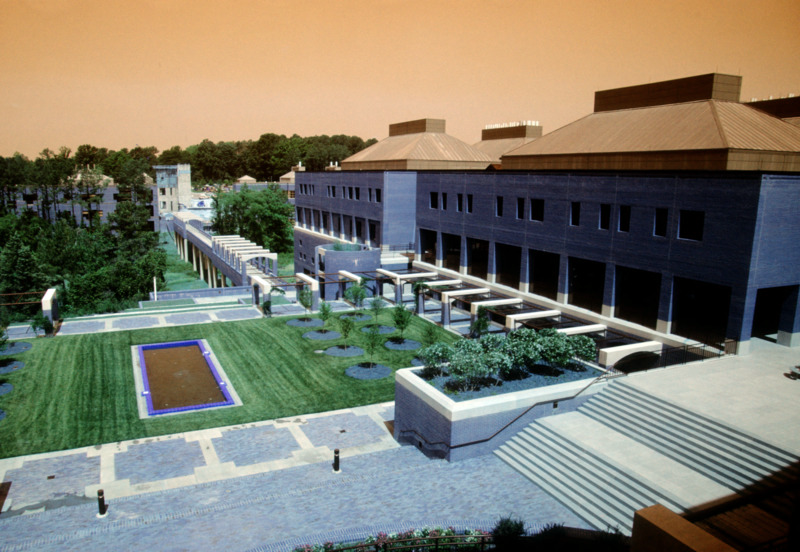

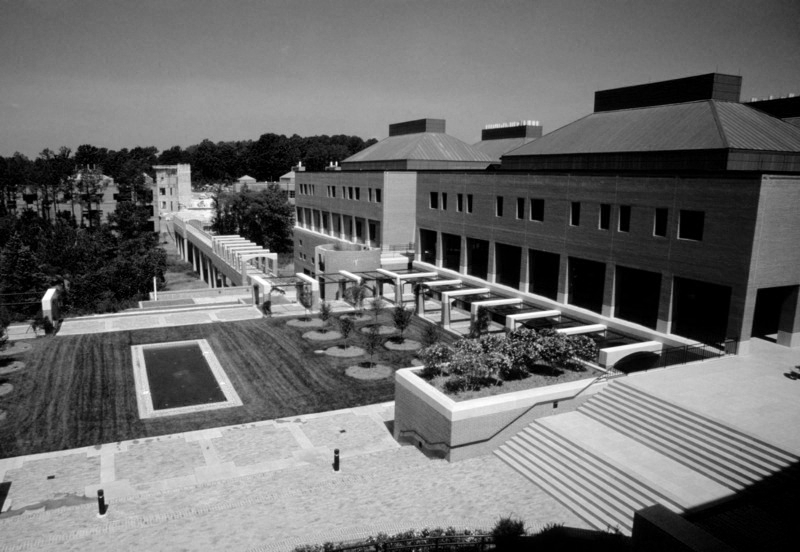

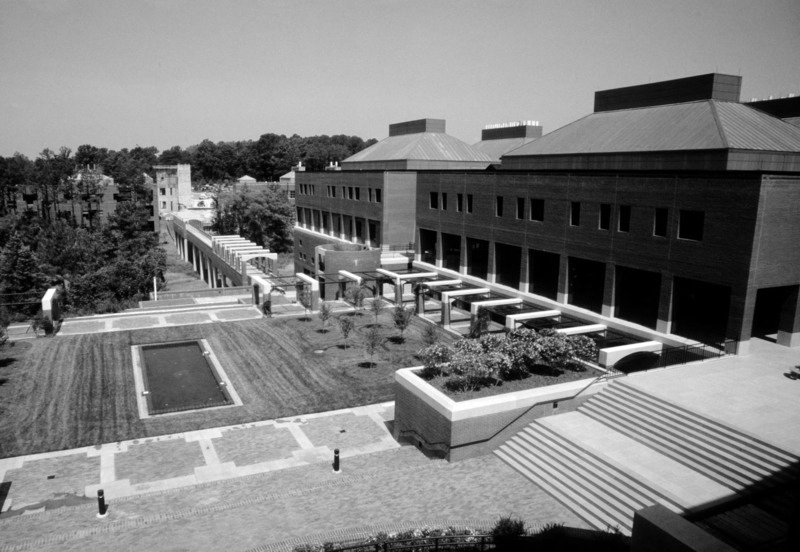

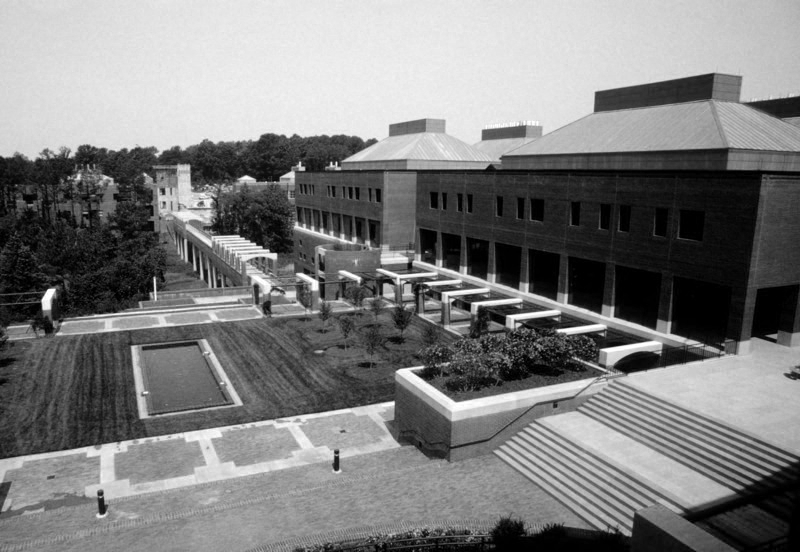

In [9]:
#separating each color. Note the order of colors
#or use split function, note that it is bgr and not rgb
B,G,R = cv2.split(image)
cv2_imshow(image)
cv2_imshow(B)
cv2_imshow(G)
cv2_imshow(R)

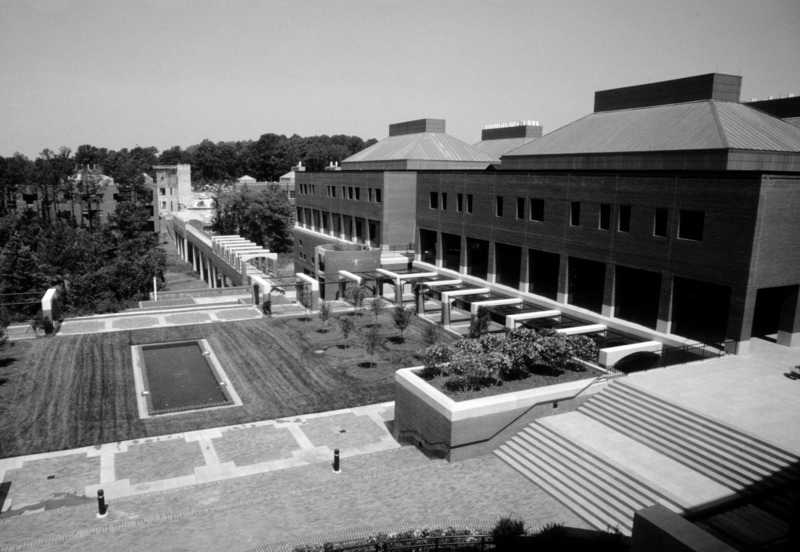

In [10]:
#Convering in grayscale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray)

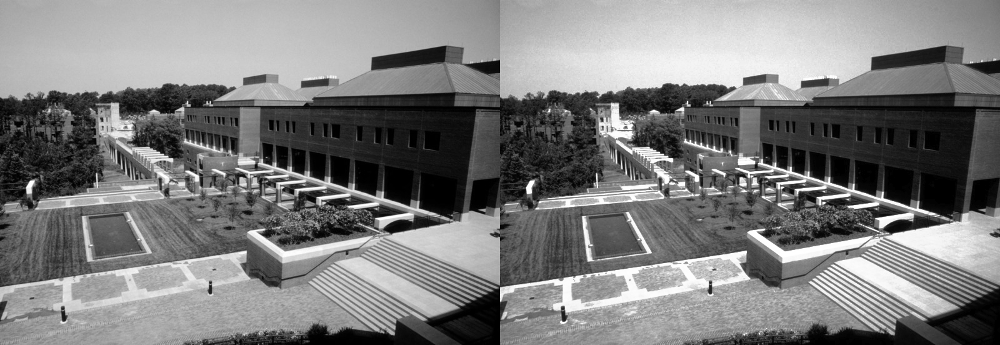

In [11]:
#6. Histogram Equalisation
output = cv2.equalizeHist(gray)
# show image input vs output
cv2_imshow(np.hstack([gray, output]))

Task 1: Read the intuition behind histogram equalisation?

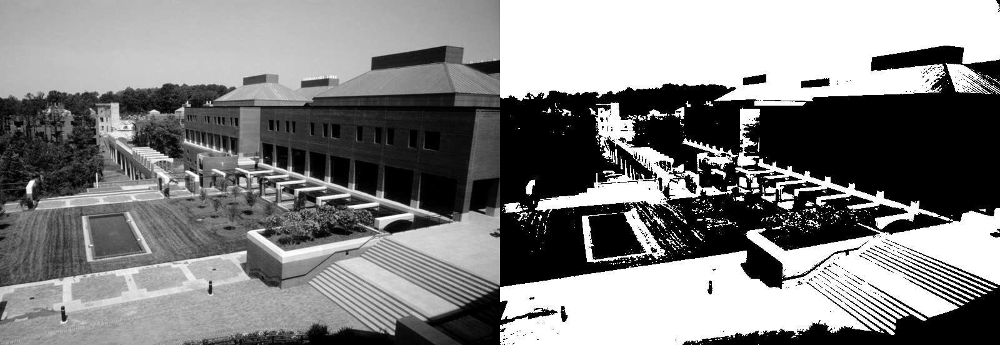

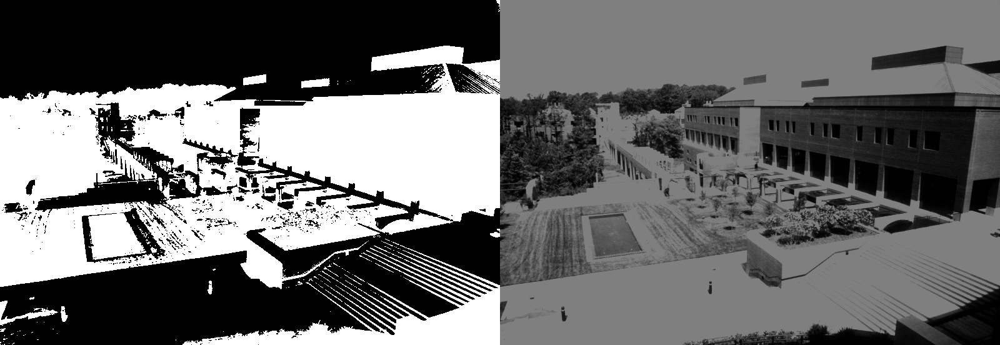

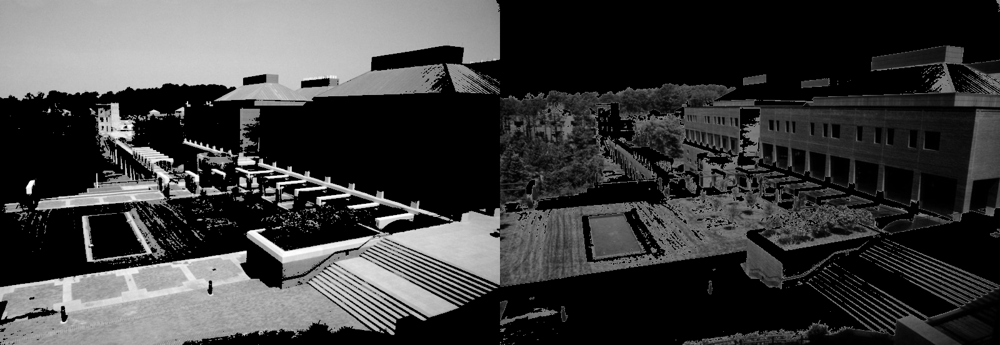

In [12]:
#Image Thresholding
#user defined thresholds
ret, thresh1 = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)
ret, thresh2 = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY_INV)
ret, thresh3 = cv2.threshold(gray, 127, 255, cv2.THRESH_TRUNC)
ret, thresh4 = cv2.threshold(gray, 127, 255, cv2.THRESH_TOZERO)
ret, thresh5 = cv2.threshold(gray, 127, 255, cv2.THRESH_TOZERO_INV)
#displaying the threshold images
cv2_imshow(np.hstack([gray, thresh1]))
cv2_imshow(np.hstack([thresh2, thresh3]))
cv2_imshow(np.hstack([thresh4, thresh5]))

Task 2: Investigate the difference between thresholding methods?

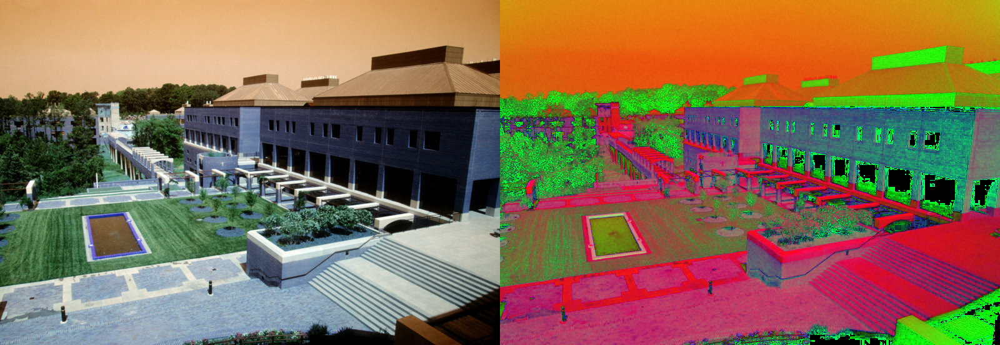

In [16]:
#HSV colorspace
#Converting in hsv
# COLOR_<current format>2<new format> 2 is just a separator
hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
#hsv value for white is 0,0,255 - h is zero by default for white, saturation is zero bcz we don't want any color in that
#value is max i.e 255
#showing the image and hsv
cv2_imshow(np.hstack([image, hsv]))

Task 3: Explore different color spaces i.e. yCbCr and Lab?

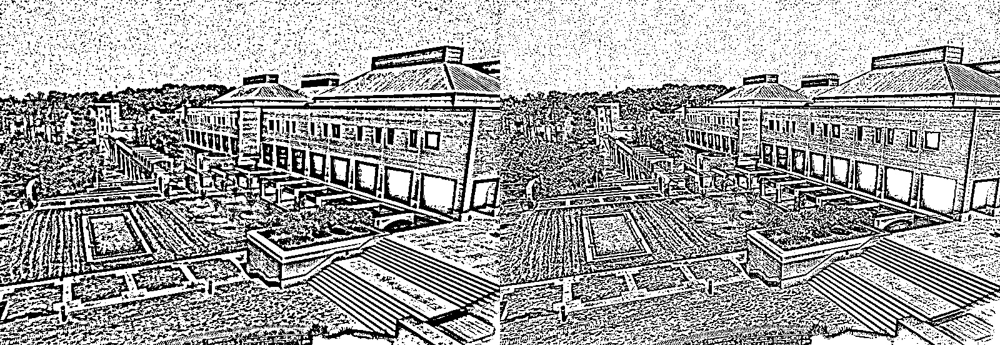

In [17]:
#Adaptive threshold
adaptive_thresh1 = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C,
cv2.THRESH_BINARY, 11, 2)
adaptive_thresh2 = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
cv2.THRESH_BINARY, 11, 2)
#displaying the threshold images
cv2_imshow(np.hstack([adaptive_thresh1,adaptive_thresh2]))

Task 4: Read the intuition adaptive thresholding?

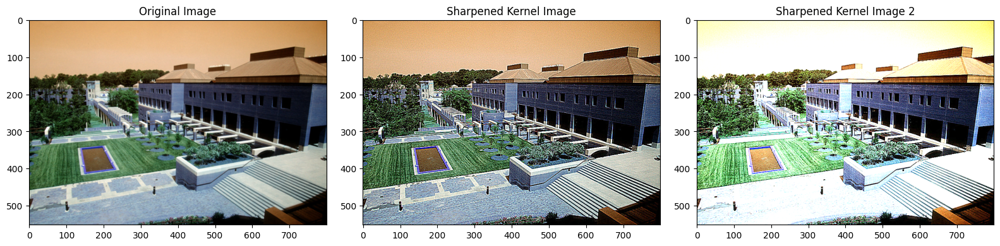

In [18]:
#9. Filtering
fig, ax = plt.subplots(1, 3, figsize=(16, 8))
fig.tight_layout()
# To conovolve the kernel on an image we can use cv.filter2D
ax[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
ax[0].set_title('Original Image')
kernel_sharpening = np.array([[-1, -1, -1],
[-1, 9, -1],
[-1, -1, -1]])
kernel_sharpening_2 = np.array([[-1, -1, -1],
[-1, 10, -1],
[-1, -1, -1]])
sharpened = cv2.filter2D(image, -1, kernel_sharpening)
ax[1].imshow(cv2.cvtColor(sharpened, cv2.COLOR_BGR2RGB))
ax[1].set_title('Sharpened Kernel Image')
sharpened_2 = cv2.filter2D(image, -1, kernel_sharpening_2)
ax[2].imshow(cv2.cvtColor(sharpened_2, cv2.COLOR_BGR2RGB))
ax[2].set_title('Sharpened Kernel Image 2')
plt.show()

Task 5: Obtain the edge images with a filter that extracts
(a) horizontal edges,
(b) vertical edges and also compute the blur image?

Template Matching:

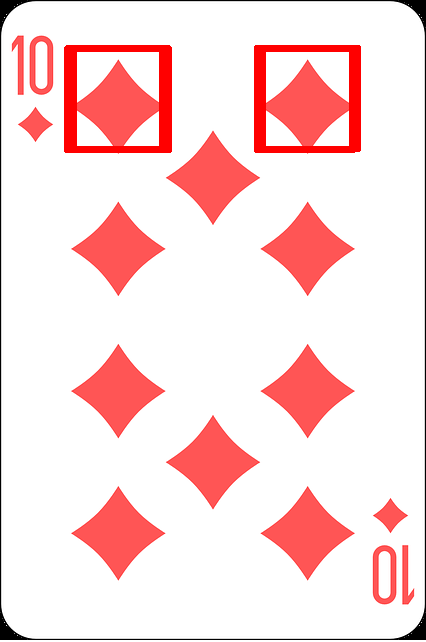

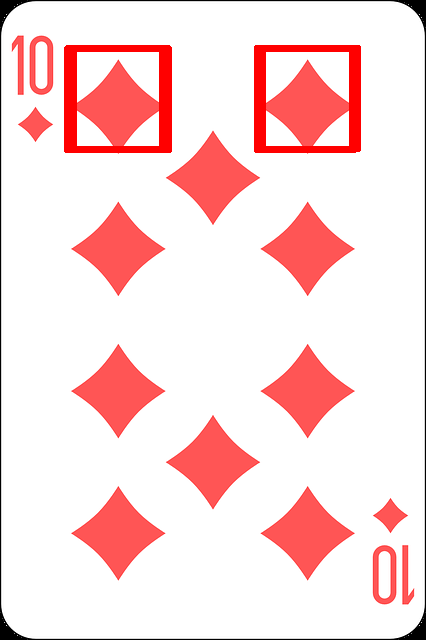

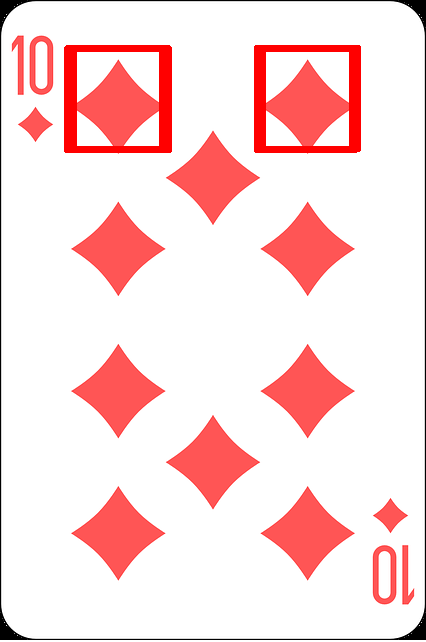

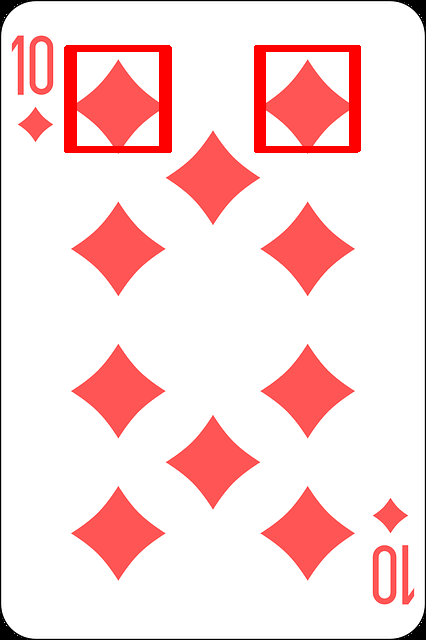

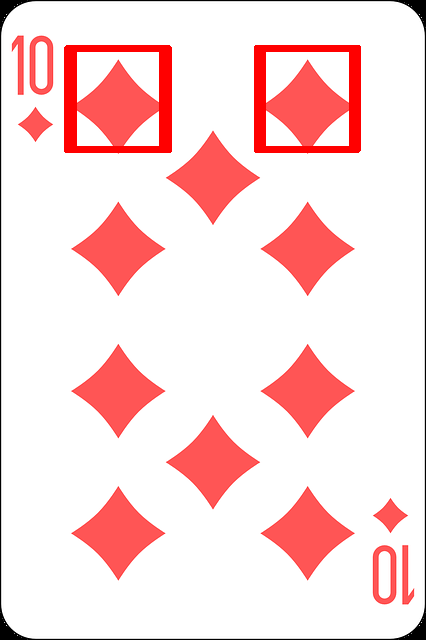

...

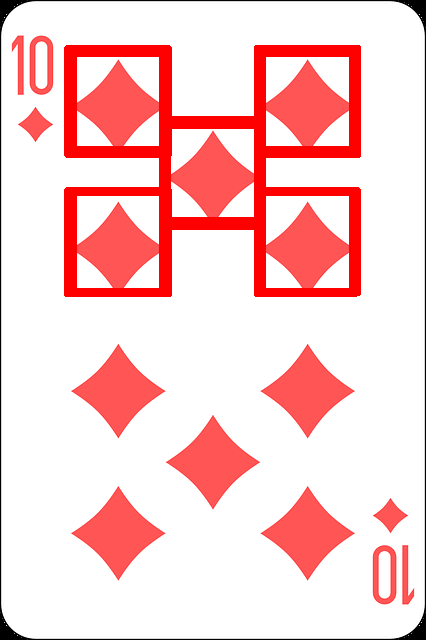

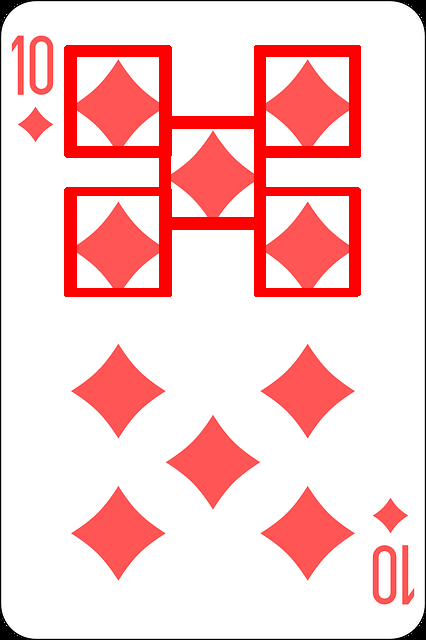

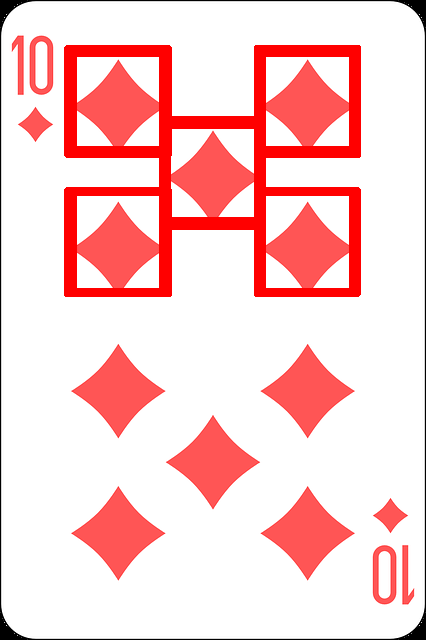

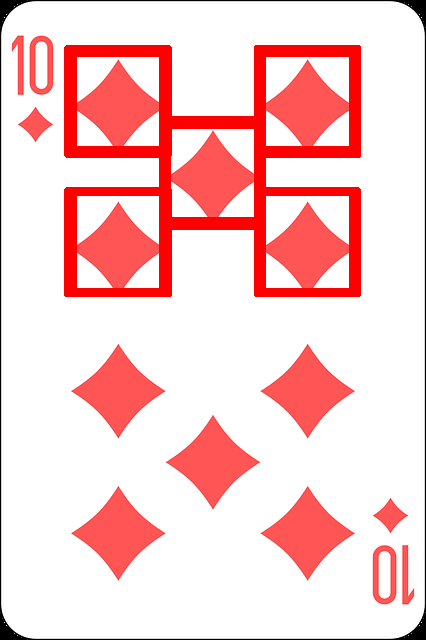

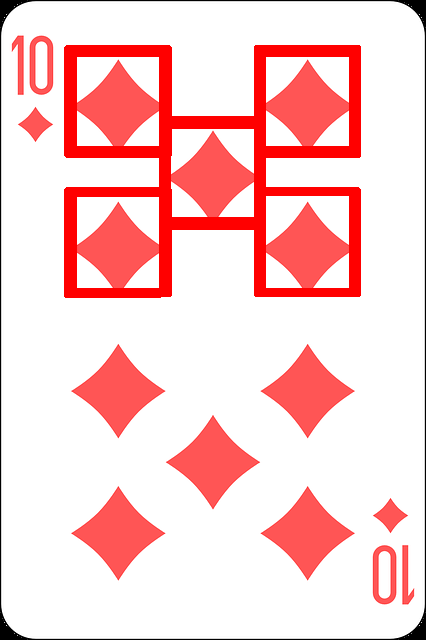

KeyboardInterrupt: 

In [22]:
from google.colab.patches import cv2_imshow
img_rgb = cv2.imread('card.png')
img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2GRAY)
template = cv2.cvtColor(cv2.imread('template.png'),cv2.COLOR_BGR2GRAY)
w, h = template.shape[::-1]
res = cv2.matchTemplate(img_gray,template,cv2.TM_CCOEFF_NORMED)
threshold = 0.8
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):

  cv2.rectangle(img_rgb, pt, (pt[0] + w, pt[1] + h), (0,0,255), 2)
  cv2.imwrite('res.png',img_rgb)
  cv2_imshow(cv2.imread('res.png'))